## Import Modules

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
import warnings
from tqdm.notebook import tqdm

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.preprocessing.image import load_img, array_to_img
from tensorflow.keras.models import Sequential , Model
from tensorflow.keras import layers
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy
warnings.filterwarnings('ignore')

## Load files

In [ ]:
!unzip -q '/content/drive/MyDrive/anime-faces.zip'

In [ ]:
Base = '/content/data'

In [ ]:
image_paths = []
for image_name in os.listdir(Base):
  image_path = os.path.join(Base, image_name)
  image_paths.append(image_path)

In [ ]:
## remove unneccessary file
image_paths.remove('/content/data/data')

In [ ]:
len(image_paths)

21551

## Visualize the image data set

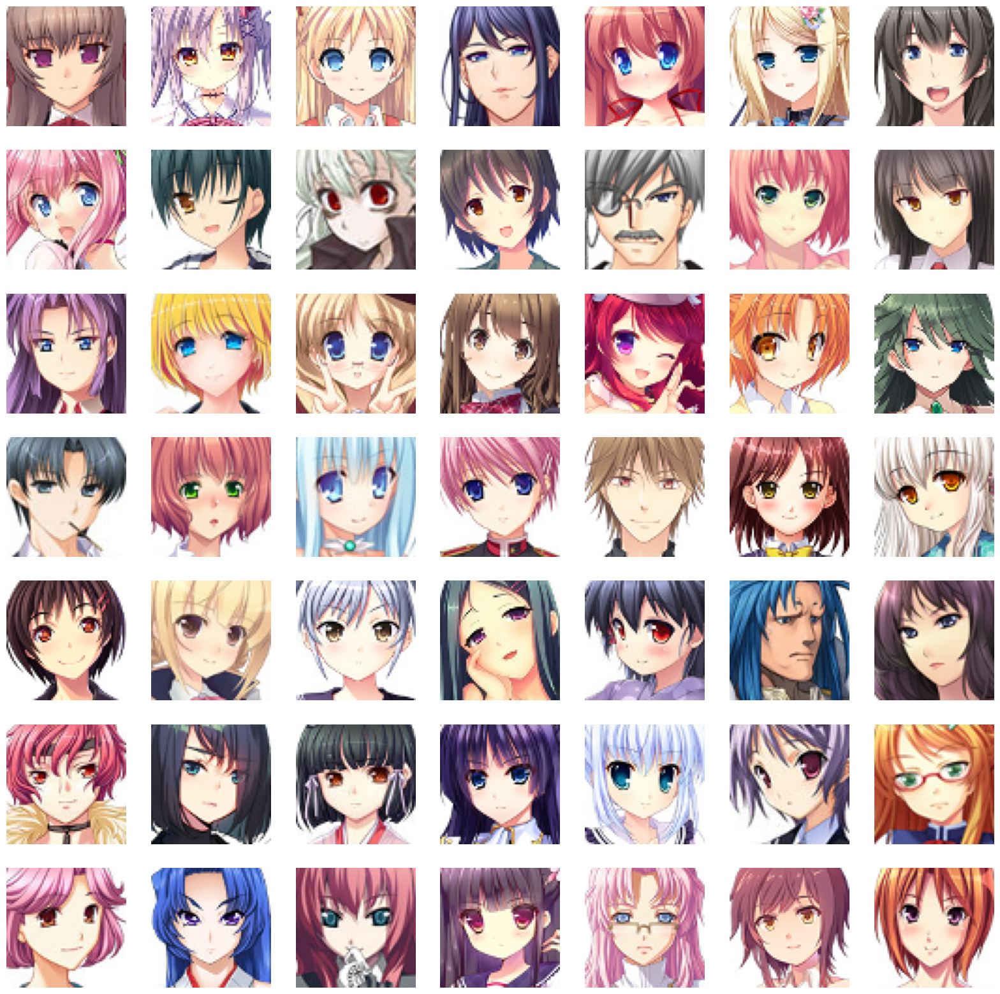

In [ ]:
## to display grid of images(7,7)
plt.figure(figsize = (20,20))
temp_images = image_paths[:49]
index = 1
for img in temp_images:
  plt.subplot(7,7, index)
  ## load image
  image = load_img(img)
  ## convert to numpy array
  image = np.array(image)
  plt.imshow(image)
  plt.axis('off')
  ## increment the index
  index+=1

## Preproces the images

In [ ]:
image_path

'/content/data/6591.png'

In [ ]:
## load the image and convert to numpy array
train_images = [np.array(load_img(path)) for path in tqdm(image_paths)]
train_images = np.array(train_images)

  0%|          | 0/21551 [00:00<?, ?it/s]

In [ ]:
train_images.shape

(21551, 64, 64, 3)

In [ ]:
## reshape the array
train_images = train_images.reshape(train_images.shape[0], 64,64,3).astype('float32')

In [ ]:
## normalize the image
train_images = (train_images-127.5)/127.5

In [ ]:
train_images[0]

array([[[ 0.92156863,  0.92156863,  0.9137255 ],
        [ 0.21568628,  0.04313726,  0.01960784],
        [ 0.48235294,  0.21568628,  0.19215687],
        ...,
        [-0.03529412, -0.30980393, -0.29411766],
        [ 0.54509807,  0.5529412 ,  0.5294118 ],
        [ 1.        ,  1.        ,  1.        ]],

       [[ 0.7411765 ,  0.7176471 ,  0.7019608 ],
        [ 0.27058825,  0.02745098,  0.00392157],
        [ 0.44313726,  0.19215687,  0.15294118],
        ...,
        [ 0.22352941, -0.09019608, -0.07450981],
        [ 0.05882353, -0.03529412, -0.04313726],
        [ 1.        ,  1.        ,  1.        ]],

       [[ 0.44313726,  0.38039216,  0.37254903],
        [ 0.33333334,  0.06666667,  0.04313726],
        [ 0.4117647 ,  0.16862746,  0.12941177],
        ...,
        [ 0.2       , -0.09803922, -0.08235294],
        [ 0.01960784, -0.19215687, -0.16078432],
        [ 0.8666667 ,  0.8745098 ,  0.8745098 ]],

       ...,

       [[ 0.3019608 ,  0.03529412,  0.02745098],
        [ 0

## Create generator and discriminator

In [ ]:
## latent dimension for random noise
Laten_dim= 100 ## for variety of images higher number means high variety
## weight initilizer
weight_init = keras.initializers.RandomNormal(mean = 0.0, stddev = 0.3)
## no. of channel for image
channels = 3 ## for grey , key it 1

## Generator Model
To generate new images from training model

In [ ]:
model = Sequential(name = 'Generator')

## 1D random noise
model.add(layers.Dense(8*8*512, input_dim = Laten_dim))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU())

## convert 1d to 3d
model.add(layers.Reshape((8,8,512)))

## upsample to 16,16
model.add(layers.Conv2DTranspose(256,(4,4), strides = (2,2), padding = 'same', kernel_initializer = weight_init))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU())

## upsample to 32,32
model.add(layers.Conv2DTranspose(128,(4,4), strides = (2,2), padding = 'same', kernel_initializer = weight_init))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU())

## upsample to 64,64
model.add(layers.Conv2DTranspose(64,(4,4), strides = (2,2), padding = 'same', kernel_initializer = weight_init))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU())
## final layer with tanh
model.add(layers.Conv2D(channels, (4,4), padding = 'same', activation = 'tanh'))
generator = model
generator.summary()

Model: "Generator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_3 (Dense)             (None, 32768)             3309568   
                                                                 
 batch_normalization_8 (Batc  (None, 32768)            131072    
 hNormalization)                                                 
                                                                 
 leaky_re_lu_3 (LeakyReLU)   (None, 32768)             0         
                                                                 
 reshape_1 (Reshape)         (None, 8, 8, 512)         0         
                                                                 
 conv2d_transpose_3 (Conv2DT  (None, 16, 16, 256)      2097408   
 ranspose)                                                       
                                                                 
 batch_normalization_9 (Batc  (None, 16, 16, 256)      10

## Discriminator Model
Discriminate the image from generator to check whether it is real or fake.

In [ ]:
model = Sequential(name  = 'discriminator')
input_shape = (64,64,3)
alpha = 0.2 ## used in leaky relu

## create conv layers
model.add(layers.Conv2D(64,(4,4), strides = (2,2), padding = 'same', input_shape = input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha = alpha))


model.add(layers.Conv2D(128,(4,4), strides = (2,2), padding = 'same', input_shape = input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha = alpha))

model.add(layers.Conv2D(128,(4,4), strides = (2,2), padding = 'same', input_shape = input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha = alpha))

model.add(layers.Flatten())
model.add(layers.Dropout(0.3))

## output class
model.add(layers.Dense(1,activation = 'sigmoid'))

discriminator = model
discriminator.summary()

Model: "discriminator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_5 (Conv2D)           (None, 32, 32, 64)        3136      
                                                                 
 batch_normalization_12 (Bat  (None, 32, 32, 64)       256       
 chNormalization)                                                
                                                                 
 leaky_re_lu_7 (LeakyReLU)   (None, 32, 32, 64)        0         
                                                                 
 conv2d_6 (Conv2D)           (None, 16, 16, 128)       131200    
                                                                 
 batch_normalization_13 (Bat  (None, 16, 16, 128)      512       
 chNormalization)                                                
                                                                 
 leaky_re_lu_8 (LeakyReLU)   (None, 16, 16, 128)     

## Create DC GAN MODEL

In [ ]:
class DCGAN(keras.Model):
  ## initializing everything
  def __init__(self, generator,discriminator, Laten_dim):
    super().__init__()
    self.generator= generator
    self.discriminator = discriminator
    self.Laten_dim = Laten_dim
    self.g_loss_metric = keras.metrics.Mean(name = 'g_loss')
    self.d_loss_metric = keras.metrics.Mean(name = 'd_loss')
  ## over write at property
  @property
  def metrics(self):
    return[self.g_loss_metric, self.d_loss_metric]
  ## compiling the model here
  def compile(self, g_optimizer, d_optimizer, loss_fn):
    super(DCGAN, self).compile()
    self.g_optimizer = g_optimizer
    self.d_optimizer = d_optimizer
    self.loss_fn = loss_fn

  def train_step(self,real_images):
    ## get batch size from the data
    batch_size = tf.shape(real_images)[0]
    ## generate random noise
    random_noise = tf.random.normal(shape = (batch_size, self.Laten_dim))
    ## train the discriminator with real(1) and fake images(0)
    with tf.GradientTape() as tape:
      pred_real = self.discriminator(real_images, training = True)
      ## generate real image labels
      real_labels = tf.ones((batch_size, 1))
      ## one side smoothing to improve the model
      real_labels += 0.5 * tf.random.uniform(tf.shape(real_labels))
      d_loss_real = self.loss_fn(real_labels, pred_real)

      ## compute loss on fake images
      fake_images = self.generator(random_noise)
      pred_fake = self.discriminator(fake_images, training = True )
      ## generate fake labels
      fake_labels = tf.zeros((batch_size, 1))
      d_loss_fake = self.loss_fn(fake_labels, pred_fake)
      ## total loss
      d_loss = (d_loss_real+ d_loss_fake)/2
    ## compute  the discrimination gradient
    gradients = tape.gradient(d_loss, self.discriminator.trainable_variables)
    ## update the gradients
    self.d_optimizer.apply_gradients(zip(gradients, self.discriminator.trainable_variables))

    ## train the generator model
    labels = tf.ones((batch_size, 1))

    ## generator want discriminator to think that fake images are real
    with tf.GradientTape() as tape:
      ### generate fake images
      fake_images = self.generator(random_noise, training = True)
      # classify as real or fake
      pred_fake = self.discriminator(fake_images, training = True)
      # compute loss
      g_loss = self.loss_fn(labels,pred_fake)
    ## compute gradients
    gradients = tape.gradient(g_loss, self.generator.trainable_variables)
    self.g_optimizer.apply_gradients(zip(gradients, self.generator.trainable_variables))
    ## update states for both models
    self.d_loss_metric.update_state(d_loss)
    self.g_loss_metric.update_state(g_loss)
    return {'d_loss': self.d_loss_metric.result(), 'g_loss': self.g_loss_metric.result()}


In [ ]:
class DCGANMonitor(keras.callbacks.Callback):
  def __init__ (self, num_imgs = 25, Laten_dim = 100):
    self.num_imgs = num_imgs
    self.Laten_dim = Laten_dim
    ## create random noise for image generation
    self.noise = tf.random.normal([25,Laten_dim])

  def on_epoch_end(self, epoch, logs = None):
    ## generate image from noise
    g_img = self.model.generator(self.noise)
    g_img = (g_img*127.5) +127.5 ##denormalization of image
    g_img.numpy()

    fig = plt.figure(figsize = (8,8))
    for i in range(self.num_imgs):
      plt.subplot(5,5,i+1)
      img = array_to_img(g_img[i])
      plt.imshow(img)
      plt.axis('off')
    # plt.savefig('epoch_{:03d}.png'.format(epoch))
    plt.show()
  def on_train_end(self, log = None):
    self.model.generator.save('generator.h5')


In [ ]:
dcgan = DCGAN(generator = generator , discriminator = discriminator, Laten_dim = Laten_dim)

TRAIN THE DISCRIMINATOR SLOWER

In [ ]:
D_LR = 0.0001
G_LR = 0.0004
dcgan.compile(g_optimizer = Adam(learning_rate = G_LR, beta_1 = 0.5), d_optimizer = Adam(learning_rate = D_LR, beta_2 = 0.5), loss_fn  = BinaryCrossentropy(from_logits = True) )

Epoch 1/50
673/674 [============================>.] - ETA: 0s - d_loss: -0.5823 - g_loss: 0.7225

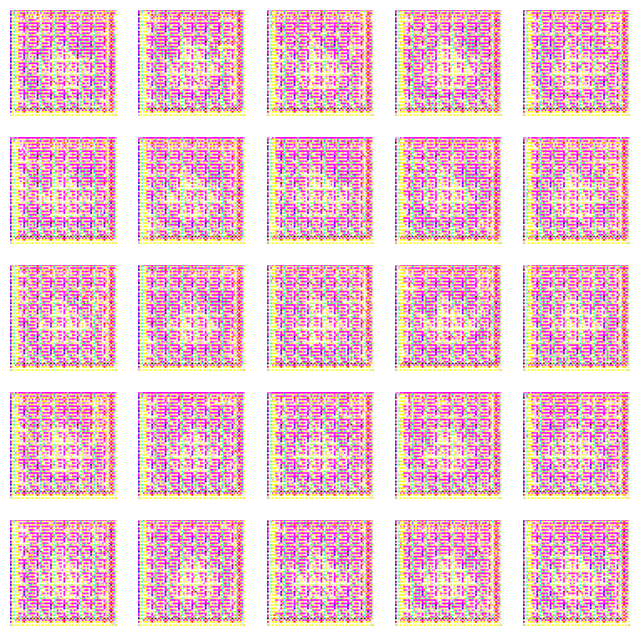

674/674 [==============================] - 60s 77ms/step - d_loss: -0.5763 - g_loss: 0.7221
Epoch 2/50
673/674 [============================>.] - ETA: 0s - d_loss: -7.1981 - g_loss: 3.8253

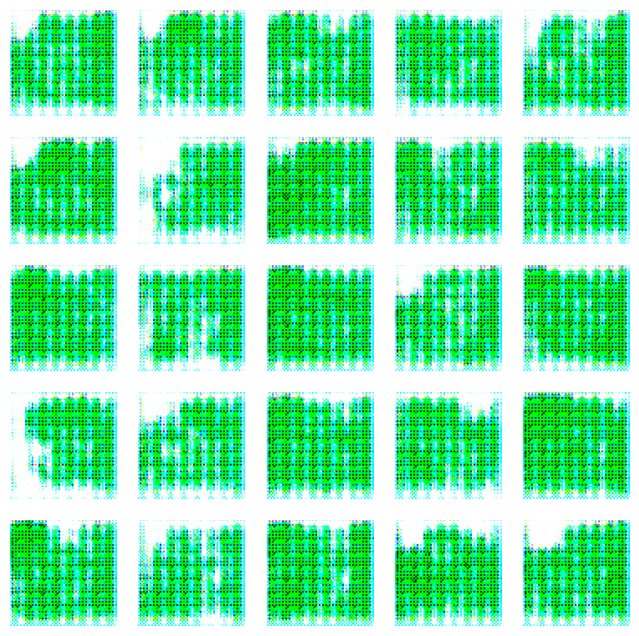

674/674 [==============================] - 54s 80ms/step - d_loss: -7.2264 - g_loss: 3.8196
Epoch 3/50
673/674 [============================>.] - ETA: 0s - d_loss: -30.7396 - g_loss: 0.1096

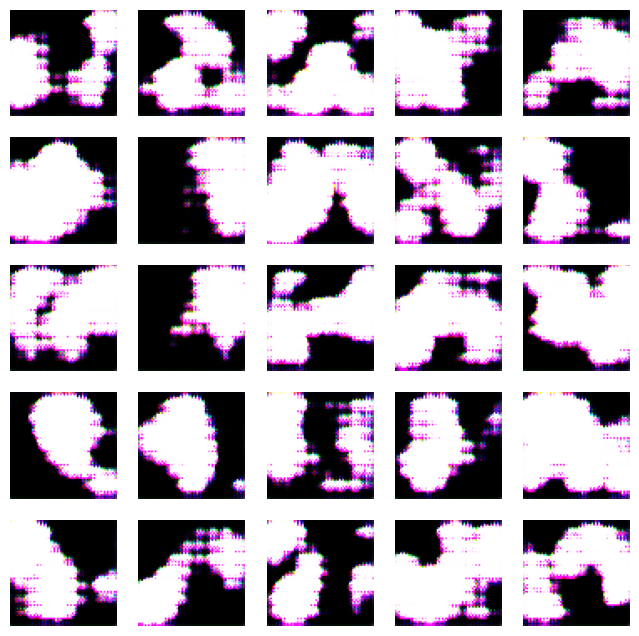

674/674 [==============================] - 54s 80ms/step - d_loss: -30.7607 - g_loss: 0.1094
Epoch 4/50
673/674 [============================>.] - ETA: 0s - d_loss: -36.2493 - g_loss: 1.8877

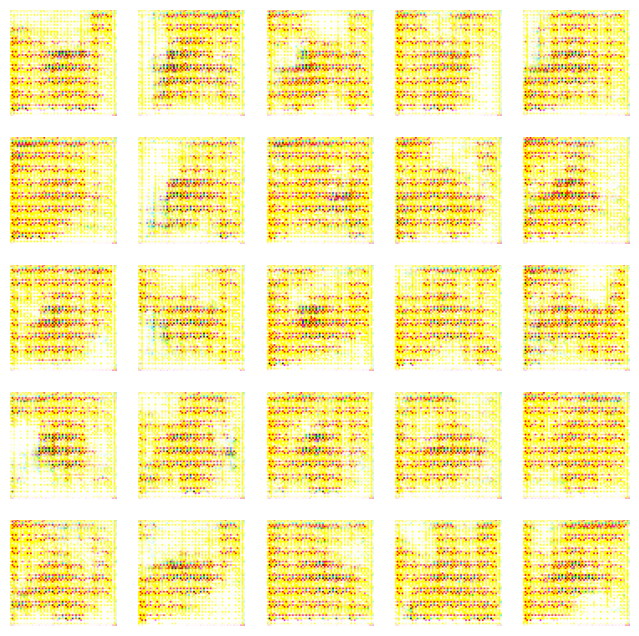

674/674 [==============================] - 54s 80ms/step - d_loss: -36.2750 - g_loss: 1.8849
Epoch 5/50
673/674 [============================>.] - ETA: 0s - d_loss: -74.7300 - g_loss: 0.8690

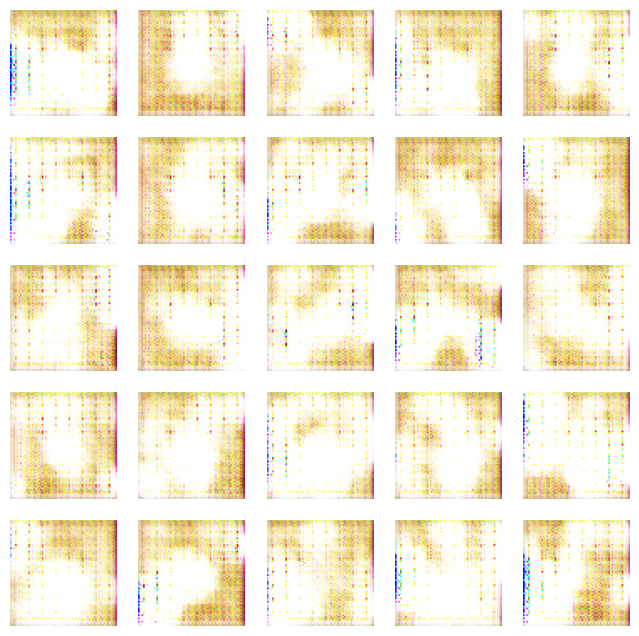

674/674 [==============================] - 54s 80ms/step - d_loss: -74.6660 - g_loss: 0.8677
Epoch 6/50
673/674 [============================>.] - ETA: 0s - d_loss: -20.9773 - g_loss: 0.7802

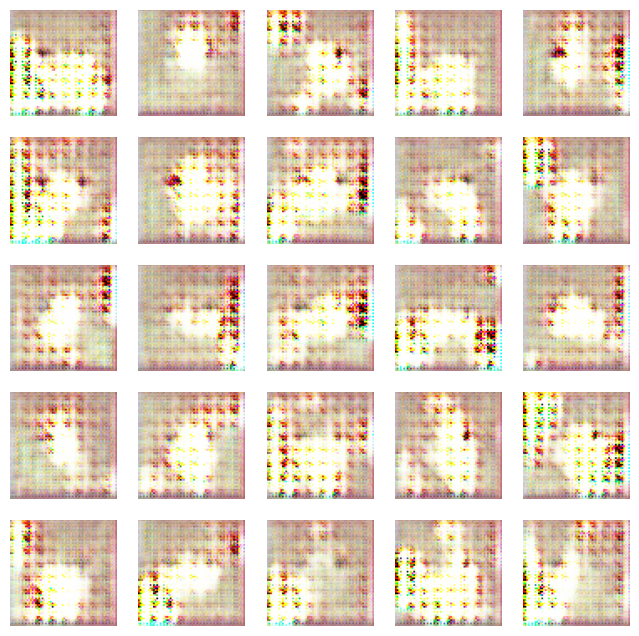

674/674 [==============================] - 55s 81ms/step - d_loss: -20.8869 - g_loss: 0.7793
Epoch 7/50
673/674 [============================>.] - ETA: 0s - d_loss: 7.1376 - g_loss: 0.9245

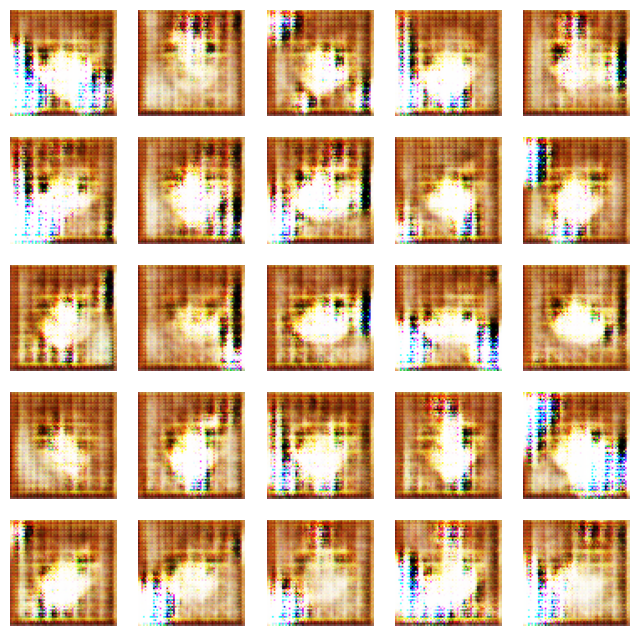

674/674 [==============================] - 55s 82ms/step - d_loss: 7.2013 - g_loss: 0.9244
Epoch 8/50
673/674 [============================>.] - ETA: 0s - d_loss: -4.5659 - g_loss: 0.5276

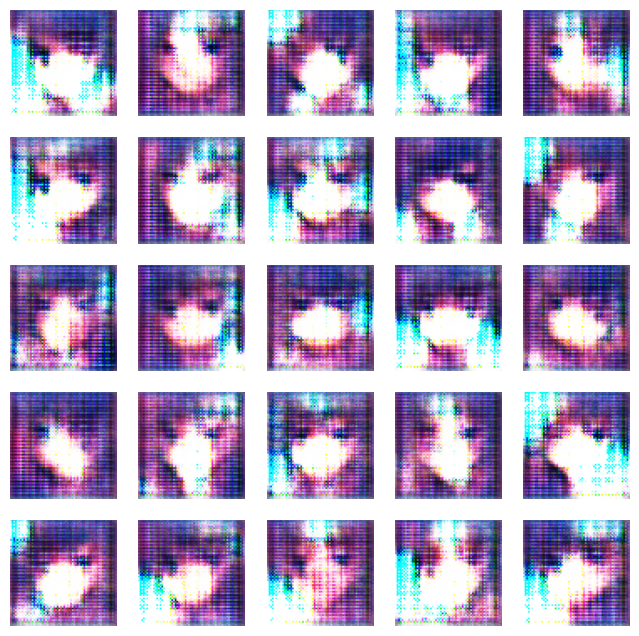

674/674 [==============================] - 55s 81ms/step - d_loss: -4.5541 - g_loss: 0.5297
Epoch 9/50
673/674 [============================>.] - ETA: 0s - d_loss: 4.0831 - g_loss: 0.8215

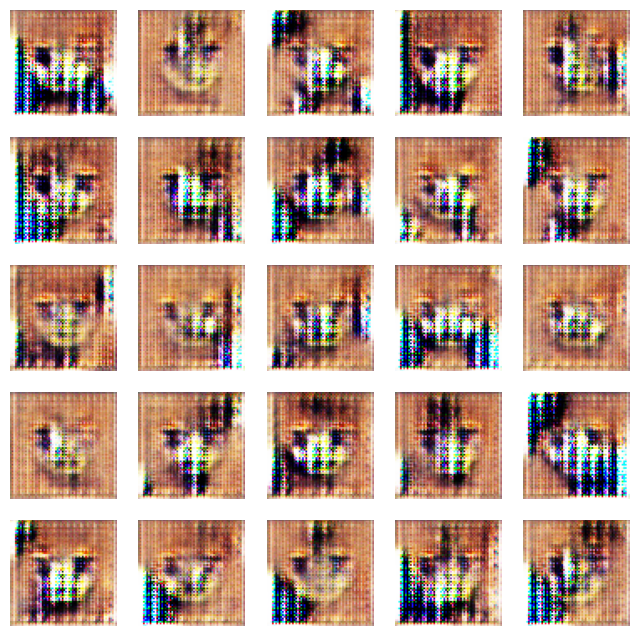

674/674 [==============================] - 56s 83ms/step - d_loss: 4.1177 - g_loss: 0.8206
Epoch 10/50
673/674 [============================>.] - ETA: 0s - d_loss: 7.7410 - g_loss: 0.5801

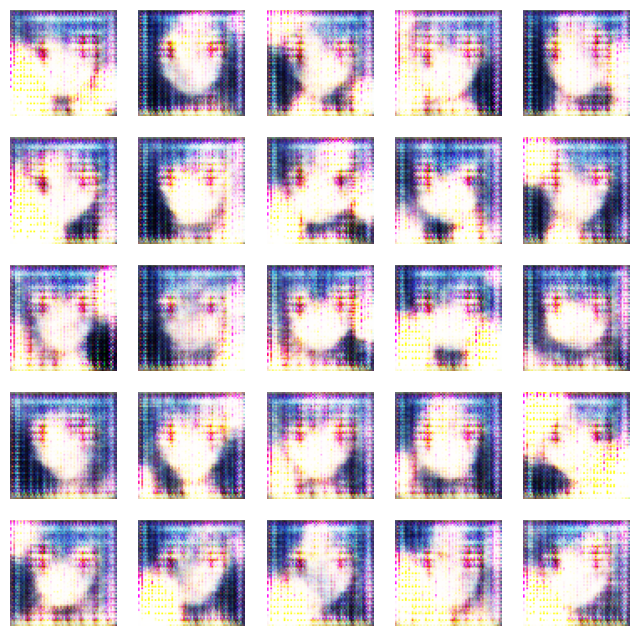

674/674 [==============================] - 55s 82ms/step - d_loss: 7.7227 - g_loss: 0.5793
Epoch 11/50
673/674 [============================>.] - ETA: 0s - d_loss: 15.1772 - g_loss: 0.5188

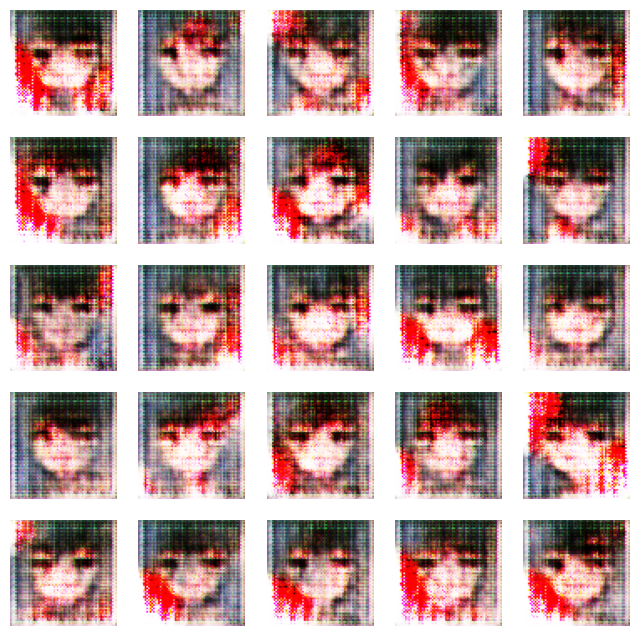

674/674 [==============================] - 55s 82ms/step - d_loss: 15.1753 - g_loss: 0.5221
Epoch 12/50
673/674 [============================>.] - ETA: 0s - d_loss: 7.4969 - g_loss: 0.3578

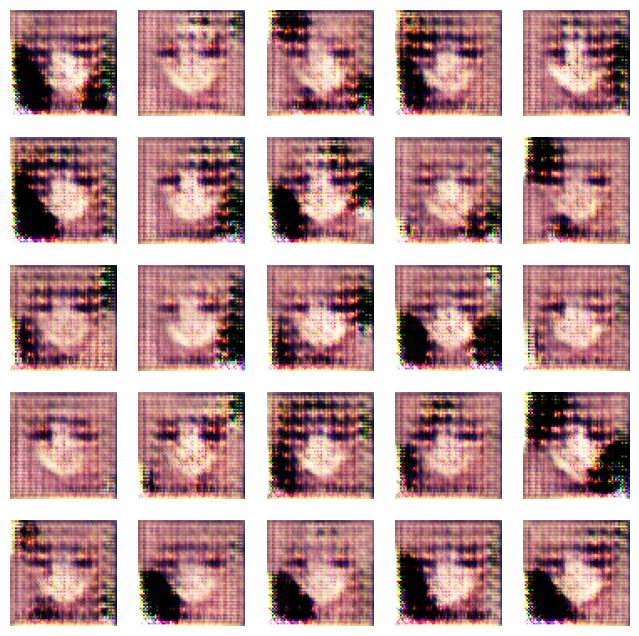

674/674 [==============================] - 56s 82ms/step - d_loss: 7.4280 - g_loss: 0.3573
Epoch 13/50
673/674 [============================>.] - ETA: 0s - d_loss: 3.6190 - g_loss: 0.2099

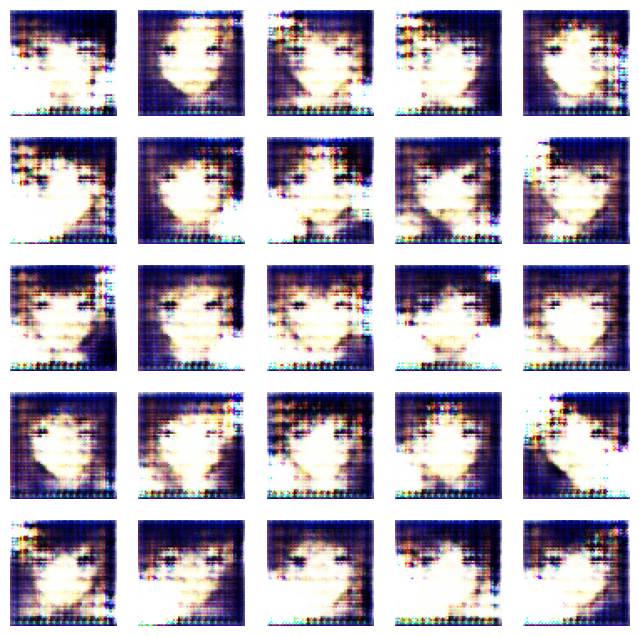

674/674 [==============================] - 54s 81ms/step - d_loss: 3.5361 - g_loss: 0.2095
Epoch 14/50
673/674 [============================>.] - ETA: 0s - d_loss: 2.8001 - g_loss: 0.2898

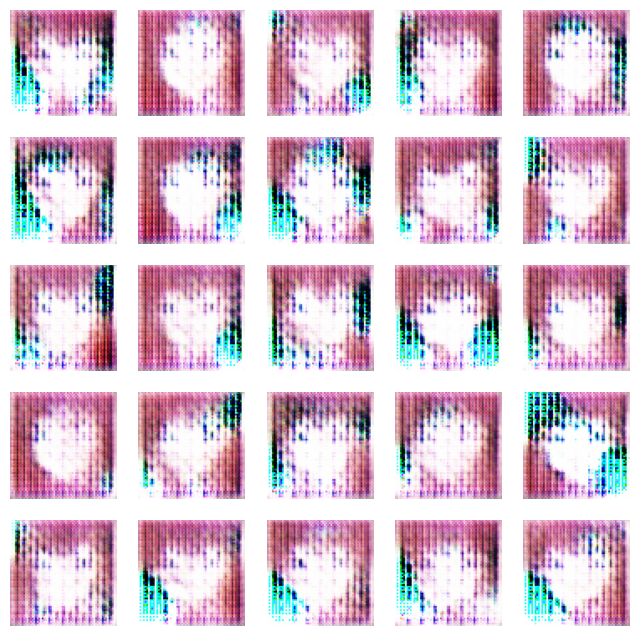

674/674 [==============================] - 55s 81ms/step - d_loss: 2.8523 - g_loss: 0.2902
Epoch 15/50
673/674 [============================>.] - ETA: 0s - d_loss: 10.6956 - g_loss: 0.2649

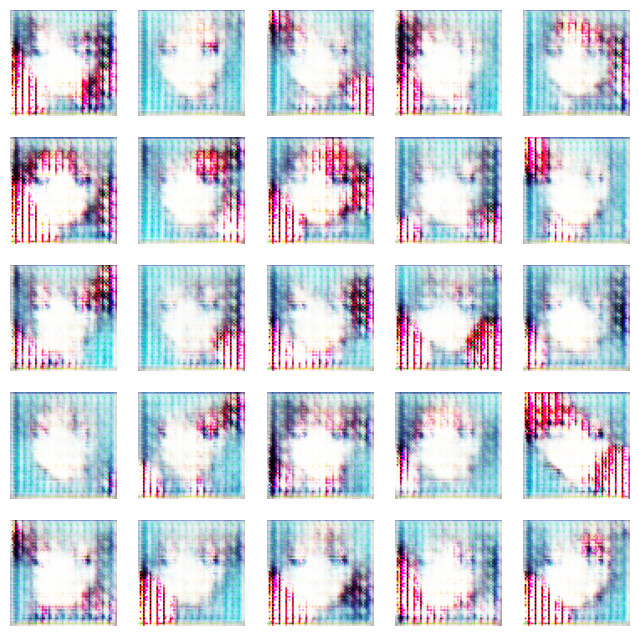

674/674 [==============================] - 55s 82ms/step - d_loss: 10.6908 - g_loss: 0.2645
Epoch 16/50
673/674 [============================>.] - ETA: 0s - d_loss: 14.6037 - g_loss: 0.2437

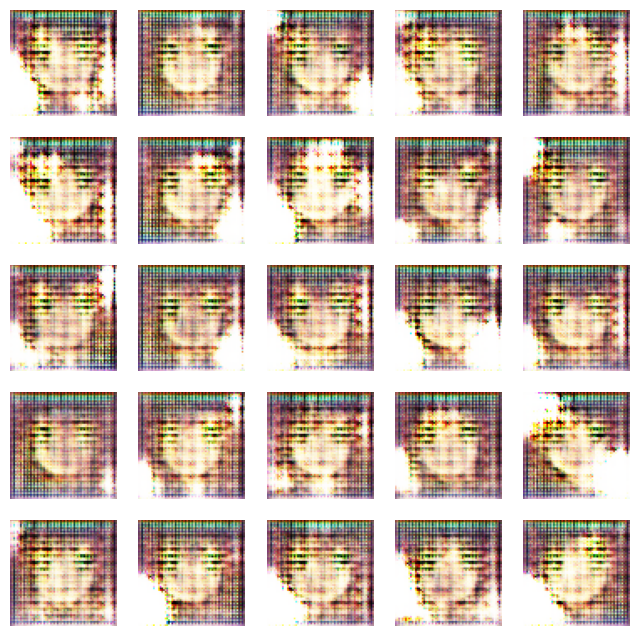

674/674 [==============================] - 55s 82ms/step - d_loss: 14.6654 - g_loss: 0.2433
Epoch 17/50
673/674 [============================>.] - ETA: 0s - d_loss: 16.7023 - g_loss: 0.3150

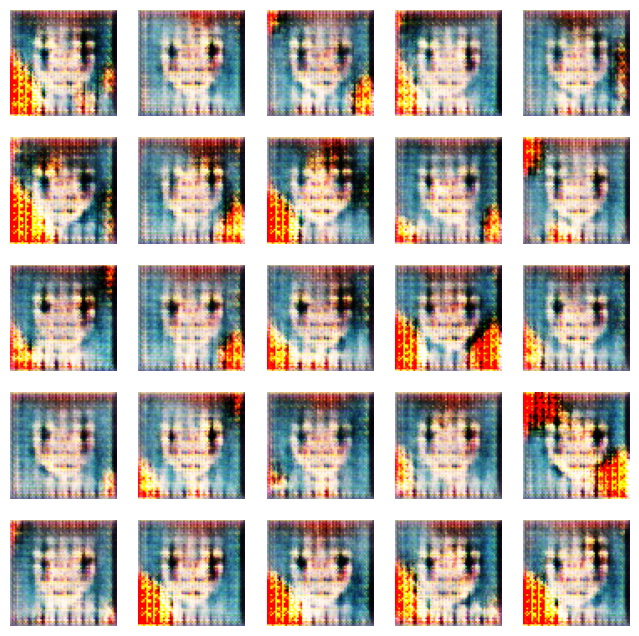

674/674 [==============================] - 55s 82ms/step - d_loss: 16.6876 - g_loss: 0.3145
Epoch 18/50
673/674 [============================>.] - ETA: 0s - d_loss: 13.0119 - g_loss: 0.2821

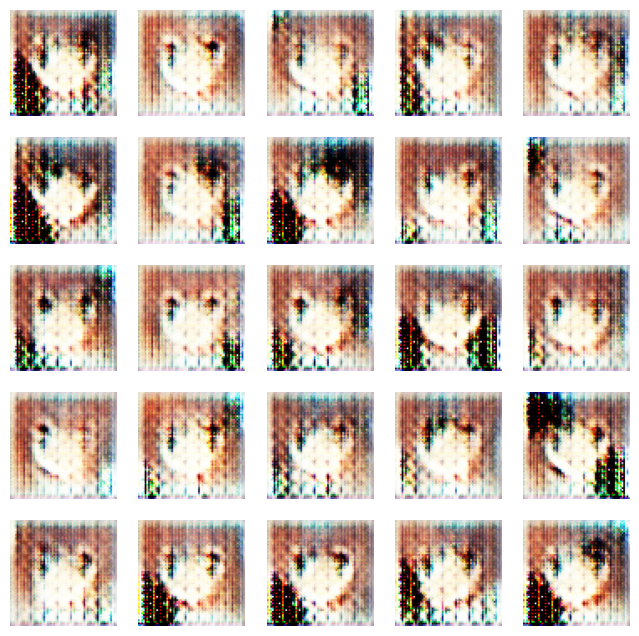

674/674 [==============================] - 56s 83ms/step - d_loss: 12.9794 - g_loss: 0.2823
Epoch 19/50
673/674 [============================>.] - ETA: 0s - d_loss: 11.9512 - g_loss: 0.3026

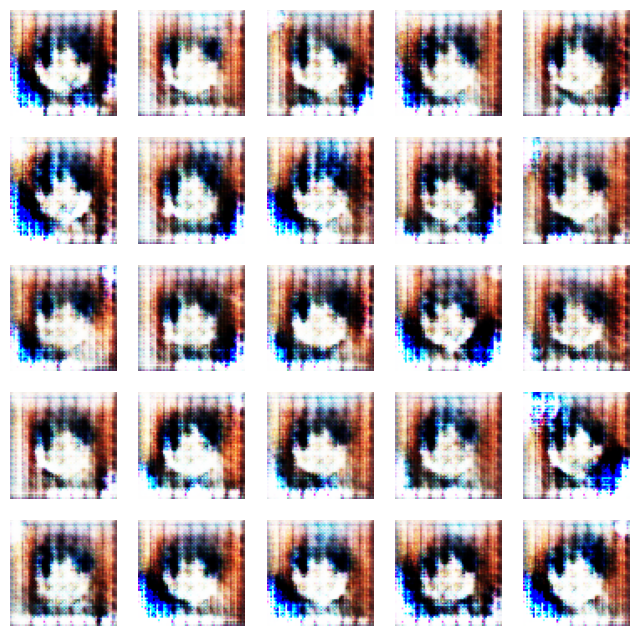

674/674 [==============================] - 55s 82ms/step - d_loss: 11.8962 - g_loss: 0.3021
Epoch 20/50
673/674 [============================>.] - ETA: 0s - d_loss: -7.5810 - g_loss: 0.1046

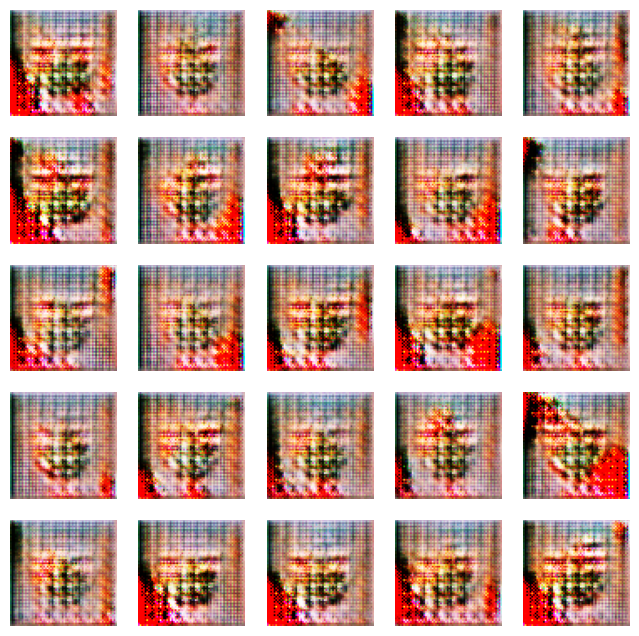

674/674 [==============================] - 55s 81ms/step - d_loss: -7.5513 - g_loss: 0.1044
Epoch 21/50
673/674 [============================>.] - ETA: 0s - d_loss: 15.7332 - g_loss: 0.2081

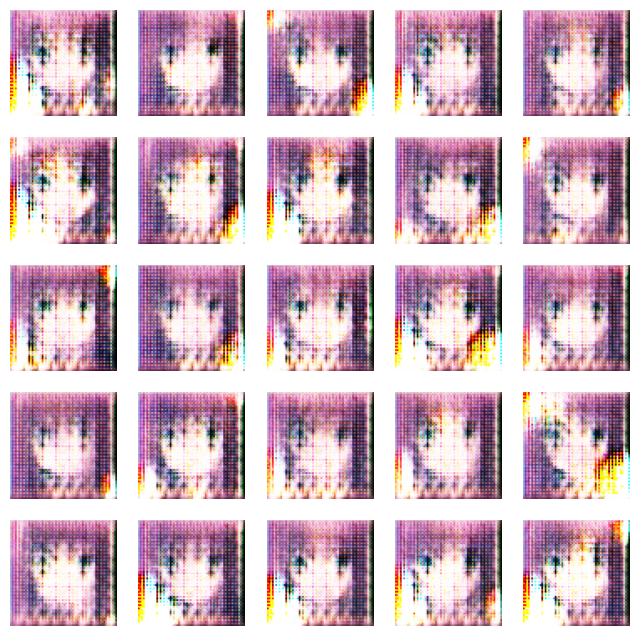

674/674 [==============================] - 55s 81ms/step - d_loss: 15.7839 - g_loss: 0.2079
Epoch 22/50
673/674 [============================>.] - ETA: 0s - d_loss: 15.5466 - g_loss: 0.1822

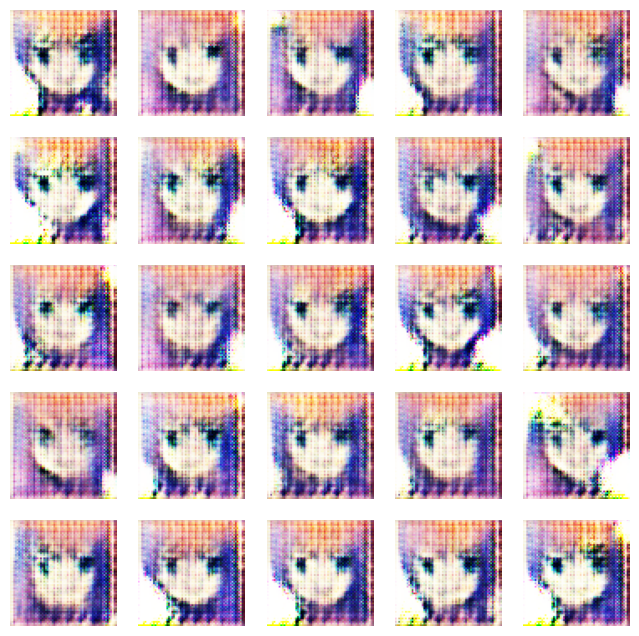

674/674 [==============================] - 55s 81ms/step - d_loss: 15.5781 - g_loss: 0.1820
Epoch 23/50
673/674 [============================>.] - ETA: 0s - d_loss: 22.6732 - g_loss: 0.2462

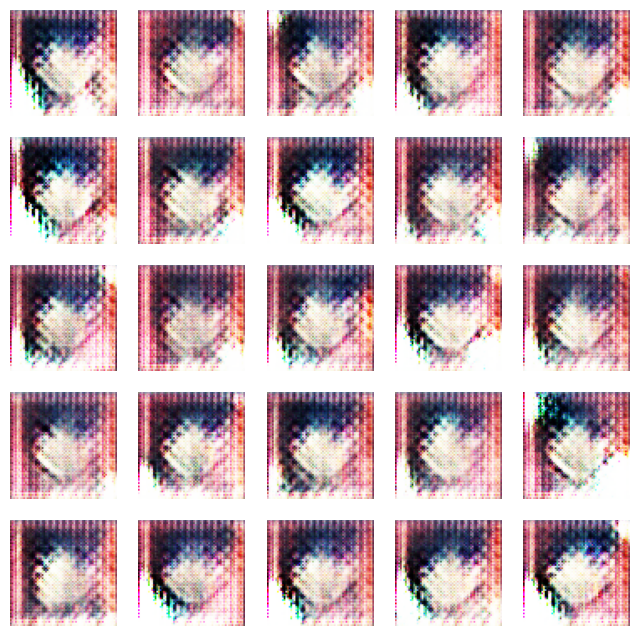

674/674 [==============================] - 55s 81ms/step - d_loss: 22.7063 - g_loss: 0.2458
Epoch 24/50
673/674 [============================>.] - ETA: 0s - d_loss: 16.4733 - g_loss: 0.2832

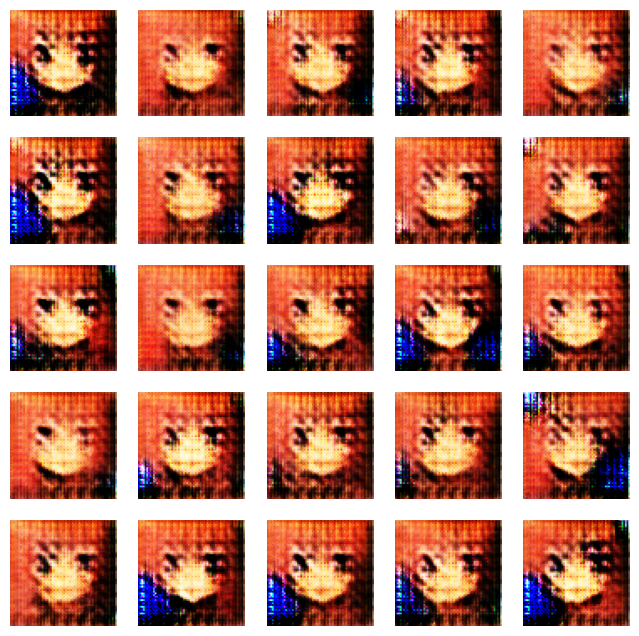

674/674 [==============================] - 56s 83ms/step - d_loss: 16.4620 - g_loss: 0.2828
Epoch 25/50
673/674 [============================>.] - ETA: 0s - d_loss: 15.8462 - g_loss: 0.1778

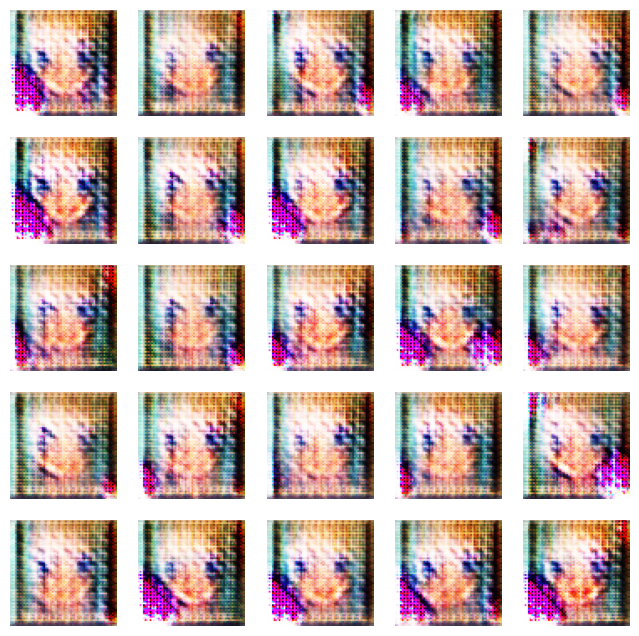

674/674 [==============================] - 55s 82ms/step - d_loss: 15.8658 - g_loss: 0.1775
Epoch 26/50
673/674 [============================>.] - ETA: 0s - d_loss: 18.3411 - g_loss: 0.2093

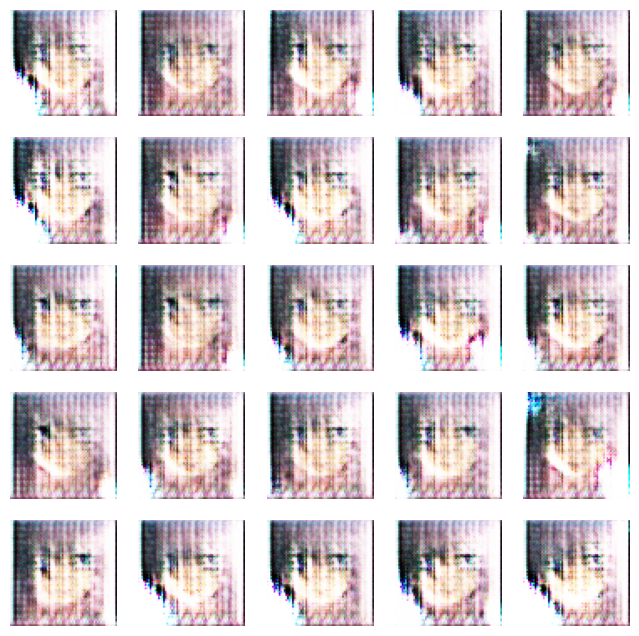

674/674 [==============================] - 55s 82ms/step - d_loss: 18.3199 - g_loss: 0.2090
Epoch 27/50
673/674 [============================>.] - ETA: 0s - d_loss: 16.5284 - g_loss: 0.2138

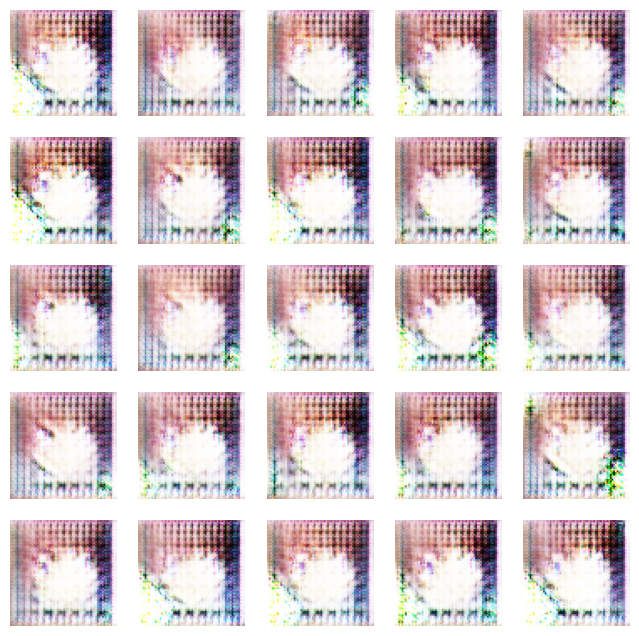

674/674 [==============================] - 55s 82ms/step - d_loss: 16.4903 - g_loss: 0.2135
Epoch 28/50
673/674 [============================>.] - ETA: 0s - d_loss: 16.2655 - g_loss: 0.1990

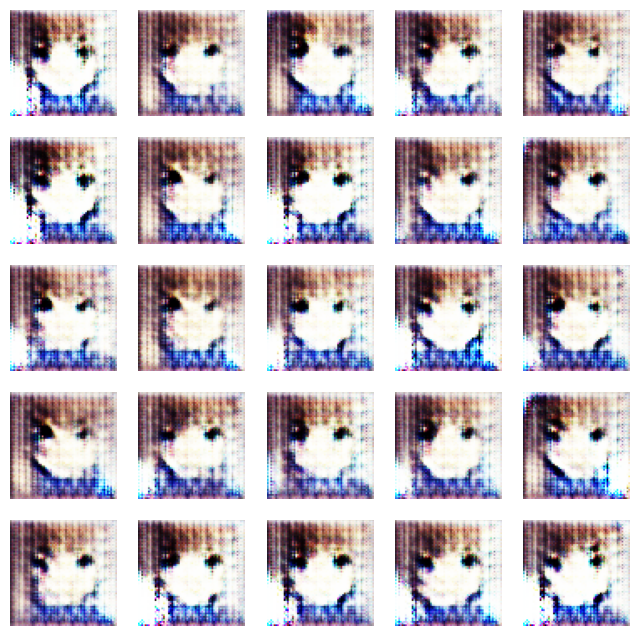

674/674 [==============================] - 55s 82ms/step - d_loss: 16.2573 - g_loss: 0.2011
Epoch 29/50
673/674 [============================>.] - ETA: 0s - d_loss: 22.6428 - g_loss: 0.2331

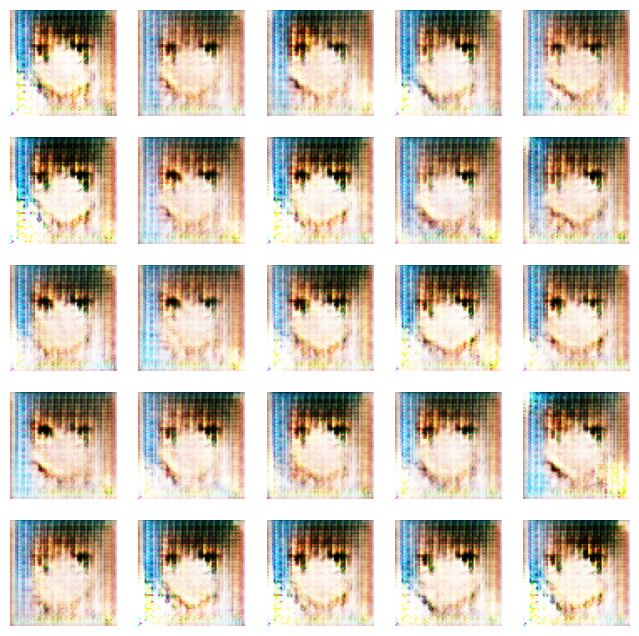

674/674 [==============================] - 55s 82ms/step - d_loss: 22.6426 - g_loss: 0.2327
Epoch 30/50
673/674 [============================>.] - ETA: 0s - d_loss: 24.6518 - g_loss: 0.2530

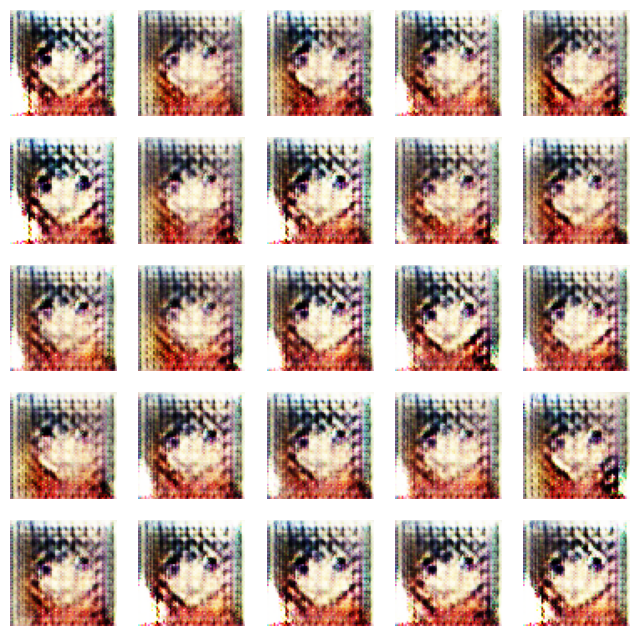

674/674 [==============================] - 56s 83ms/step - d_loss: 24.6518 - g_loss: 0.2530
Epoch 31/50
673/674 [============================>.] - ETA: 0s - d_loss: 23.4427 - g_loss: 0.2563

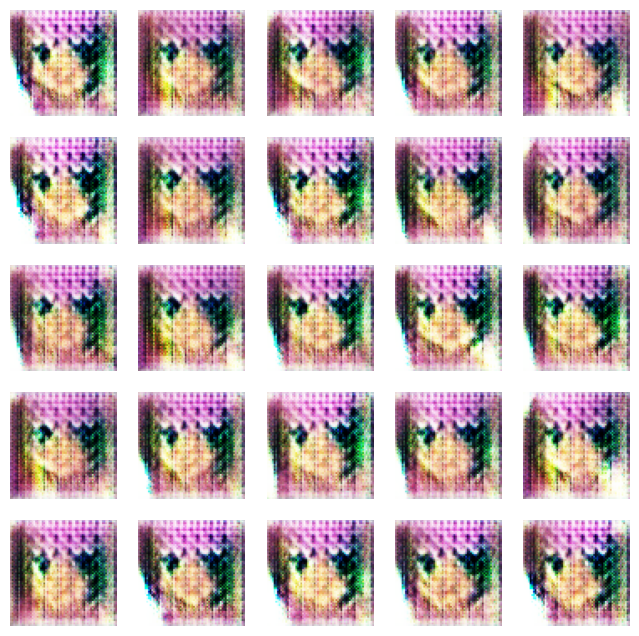

674/674 [==============================] - 56s 83ms/step - d_loss: 23.4359 - g_loss: 0.2559
Epoch 32/50
673/674 [============================>.] - ETA: 0s - d_loss: 22.2392 - g_loss: 0.3370

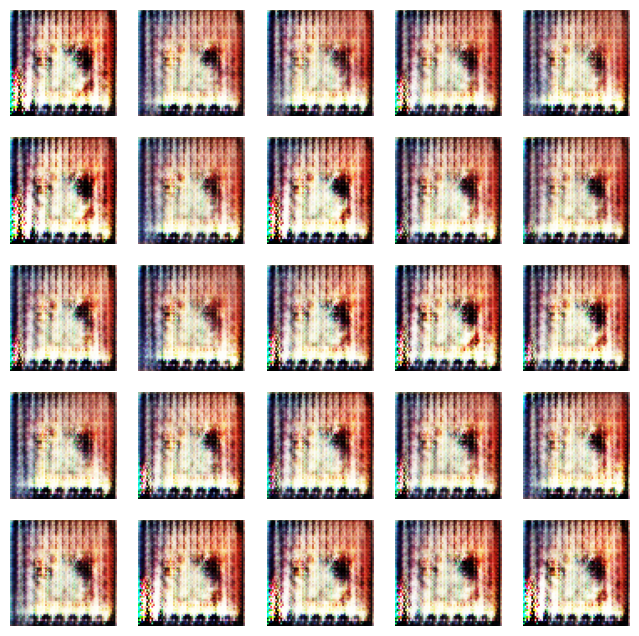

674/674 [==============================] - 56s 83ms/step - d_loss: 22.2343 - g_loss: 0.3365
Epoch 33/50
673/674 [============================>.] - ETA: 0s - d_loss: 22.2740 - g_loss: 0.3349

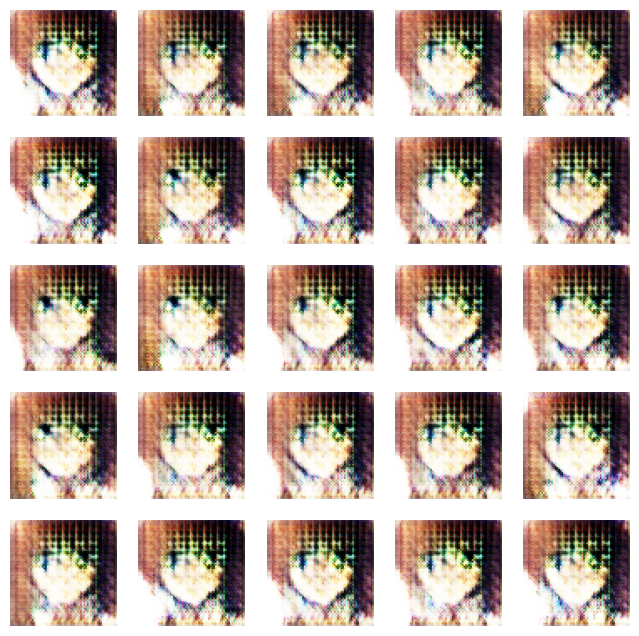

674/674 [==============================] - 55s 82ms/step - d_loss: 22.2862 - g_loss: 0.3372
Epoch 34/50
673/674 [============================>.] - ETA: 0s - d_loss: 19.9066 - g_loss: 0.4505

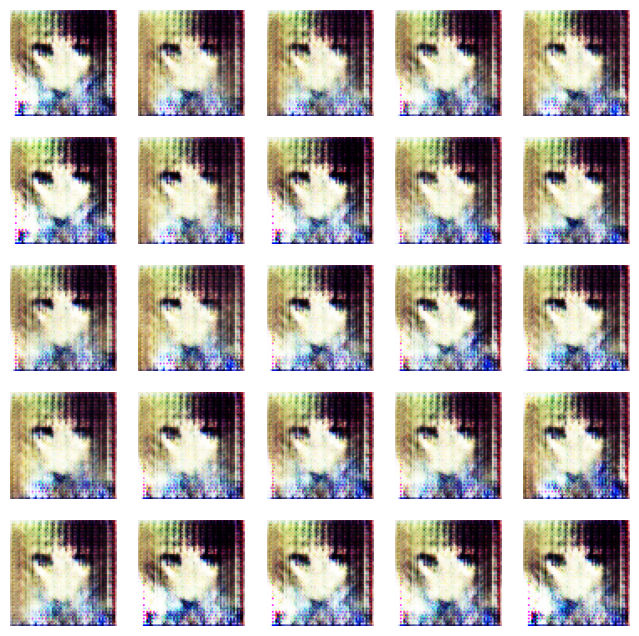

674/674 [==============================] - 55s 82ms/step - d_loss: 19.9101 - g_loss: 0.4499
Epoch 35/50
673/674 [============================>.] - ETA: 0s - d_loss: 17.9242 - g_loss: 0.6685

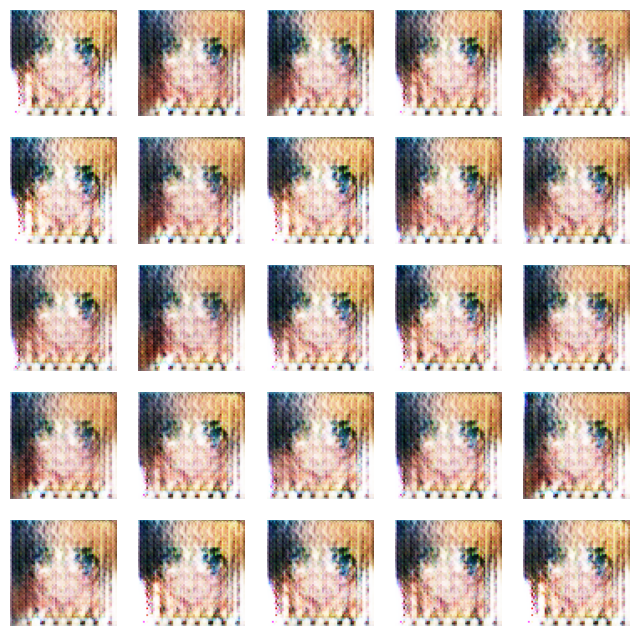

674/674 [==============================] - 55s 82ms/step - d_loss: 17.9281 - g_loss: 0.6684
Epoch 36/50
673/674 [============================>.] - ETA: 0s - d_loss: 16.8154 - g_loss: 0.6833

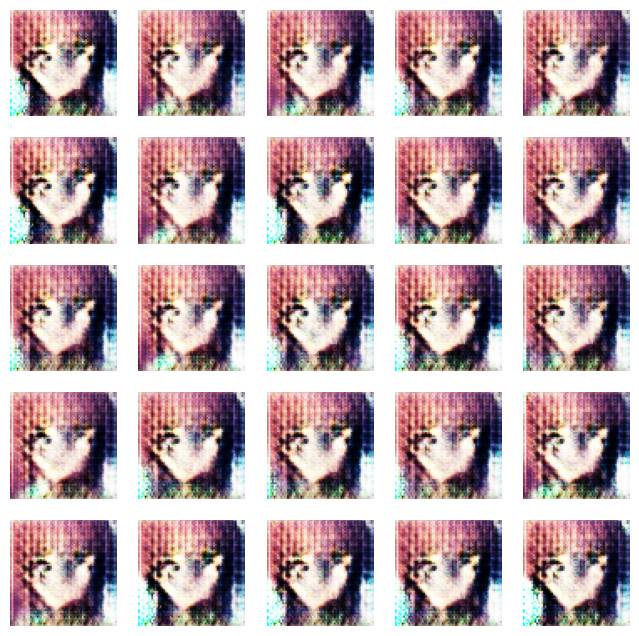

674/674 [==============================] - 56s 83ms/step - d_loss: 16.8175 - g_loss: 0.6823
Epoch 37/50
673/674 [============================>.] - ETA: 0s - d_loss: 15.1818 - g_loss: 0.8460

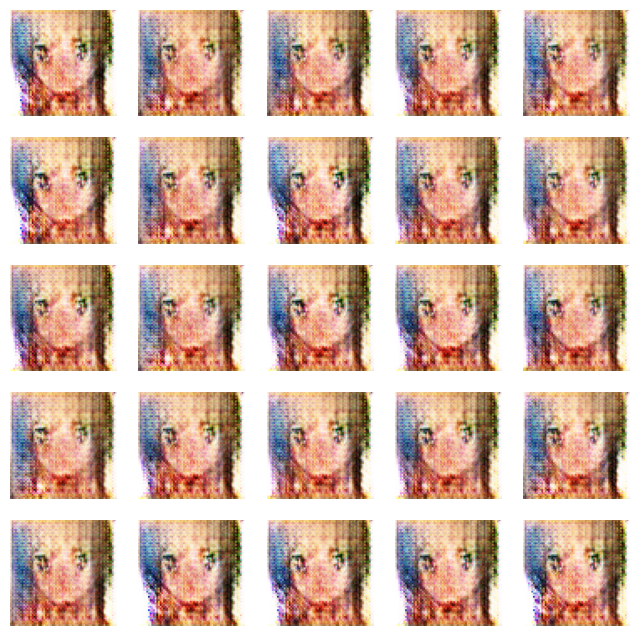

674/674 [==============================] - 56s 82ms/step - d_loss: 15.1712 - g_loss: 0.8447
Epoch 38/50
673/674 [============================>.] - ETA: 0s - d_loss: 13.5327 - g_loss: 0.8131

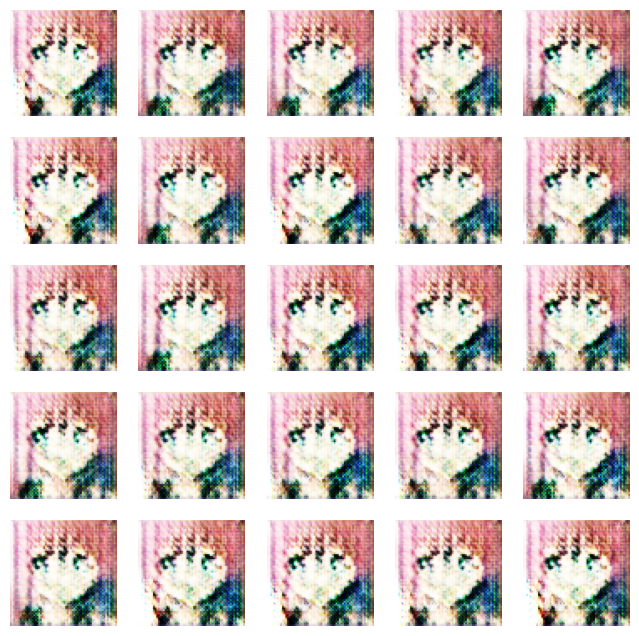

674/674 [==============================] - 56s 83ms/step - d_loss: 13.5297 - g_loss: 0.8159
Epoch 39/50
673/674 [============================>.] - ETA: 0s - d_loss: 13.1506 - g_loss: 1.0653

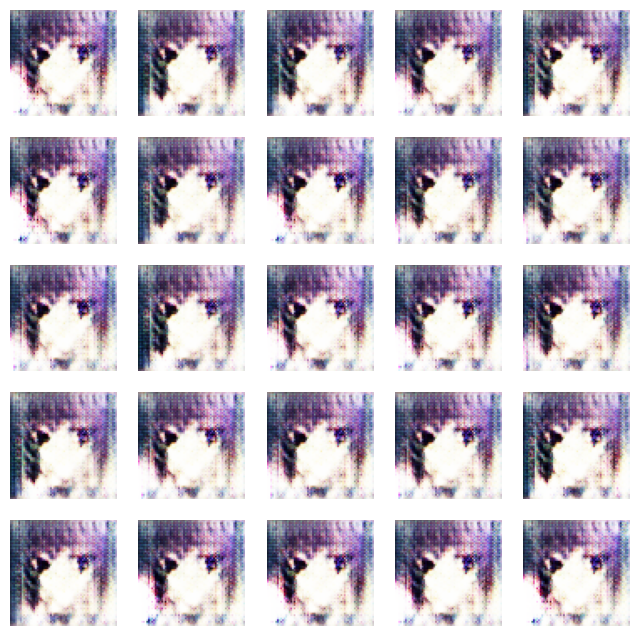

674/674 [==============================] - 56s 83ms/step - d_loss: 13.1443 - g_loss: 1.0654
Epoch 40/50
673/674 [============================>.] - ETA: 0s - d_loss: 11.7293 - g_loss: 1.0720

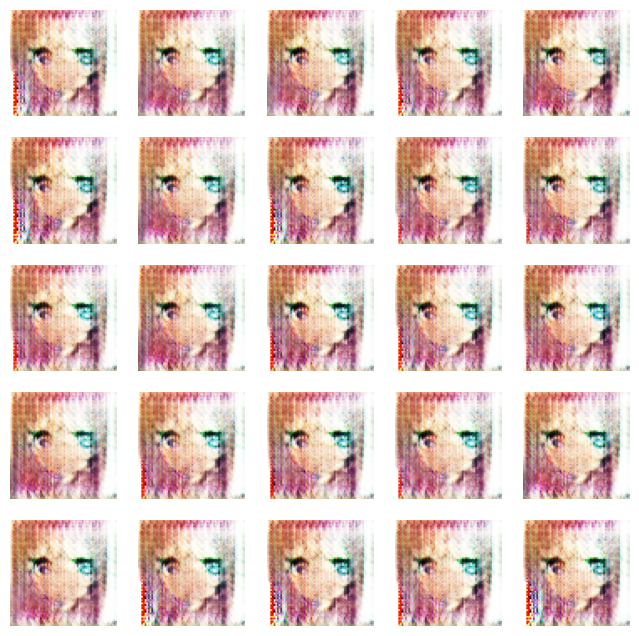

674/674 [==============================] - 55s 82ms/step - d_loss: 11.7202 - g_loss: 1.0736
Epoch 41/50
673/674 [============================>.] - ETA: 0s - d_loss: 10.5511 - g_loss: 1.1244

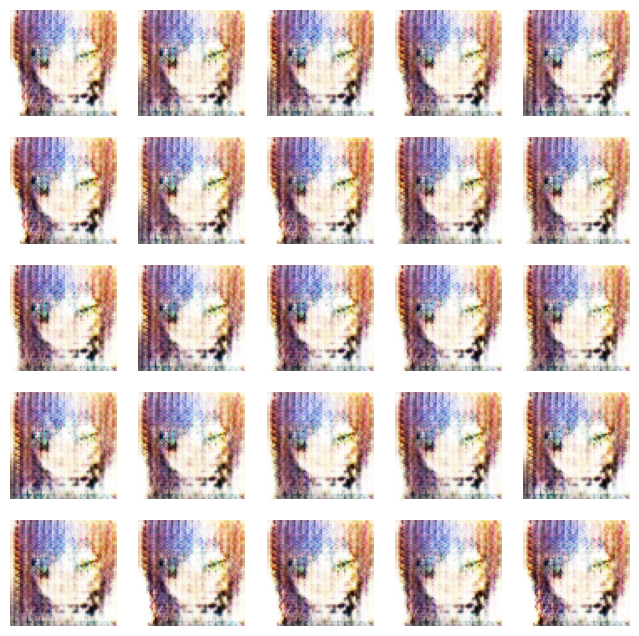

674/674 [==============================] - 55s 82ms/step - d_loss: 10.5505 - g_loss: 1.1246
Epoch 42/50
673/674 [============================>.] - ETA: 0s - d_loss: 9.0093 - g_loss: 1.2867

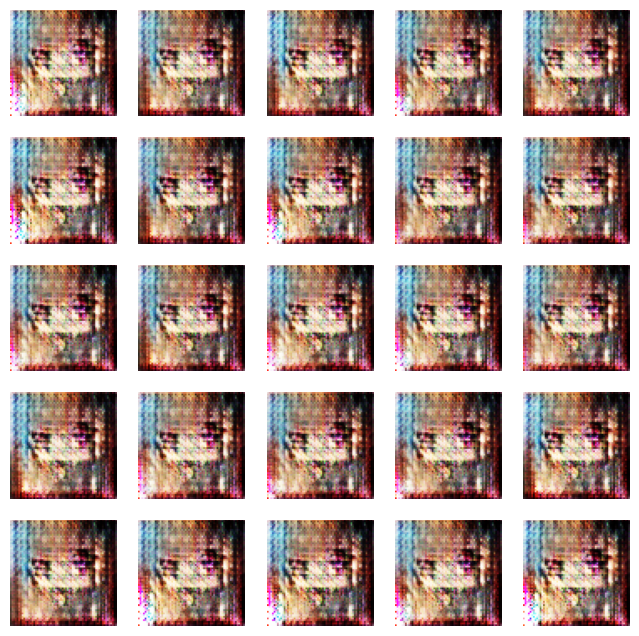

674/674 [==============================] - 56s 83ms/step - d_loss: 9.0083 - g_loss: 1.2848
Epoch 43/50
674/674 [==============================] - ETA: 0s - d_loss: 9.8999 - g_loss: 1.4523

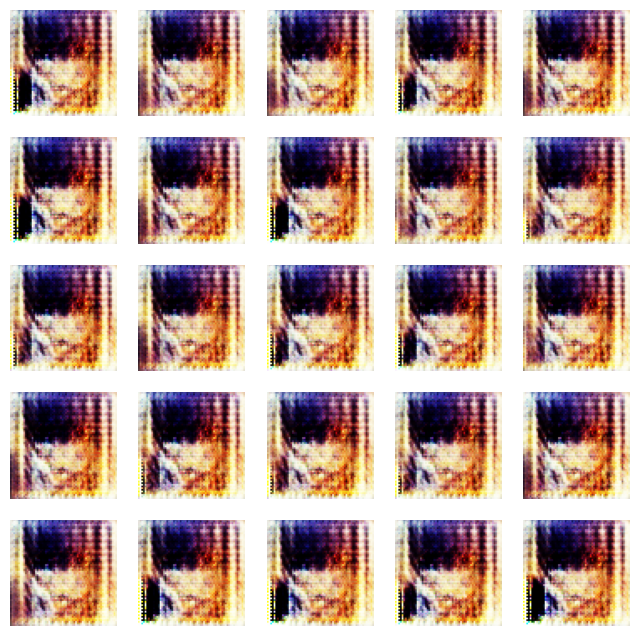

674/674 [==============================] - 56s 82ms/step - d_loss: 9.8999 - g_loss: 1.4523
Epoch 44/50
673/674 [============================>.] - ETA: 0s - d_loss: 9.6285 - g_loss: 1.5423

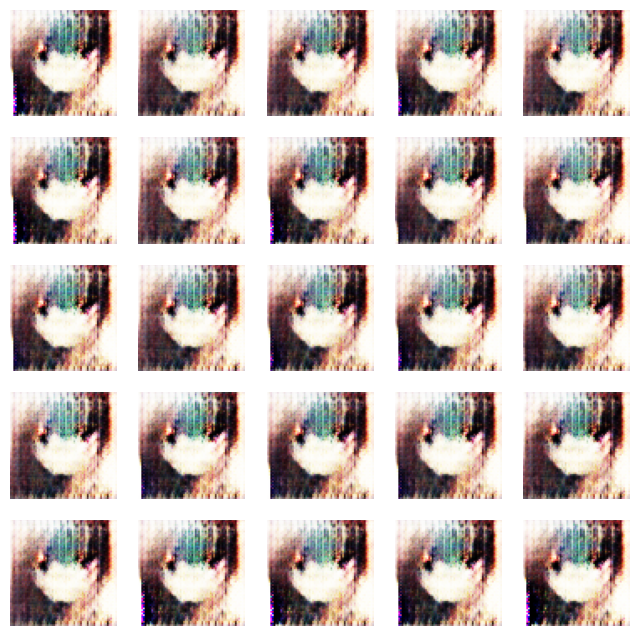

674/674 [==============================] - 56s 83ms/step - d_loss: 9.6228 - g_loss: 1.5451
Epoch 45/50
673/674 [============================>.] - ETA: 0s - d_loss: 8.7482 - g_loss: 1.2572

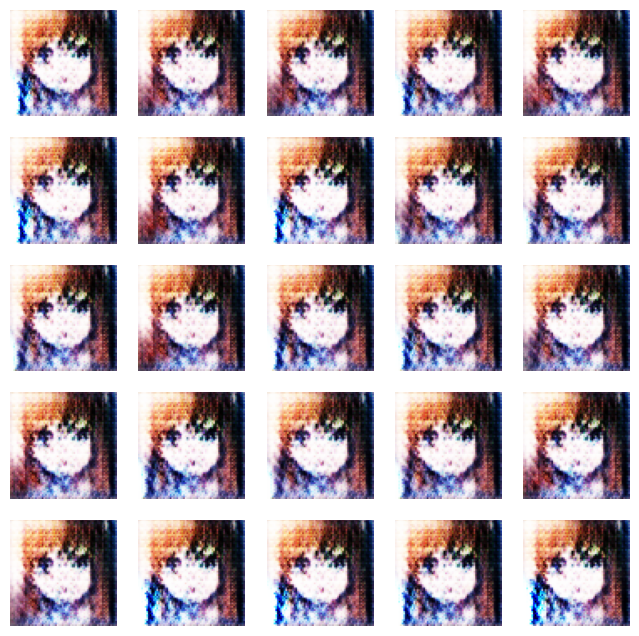

674/674 [==============================] - 55s 82ms/step - d_loss: 8.7554 - g_loss: 1.2575
Epoch 46/50
673/674 [============================>.] - ETA: 0s - d_loss: 8.7414 - g_loss: 1.6955

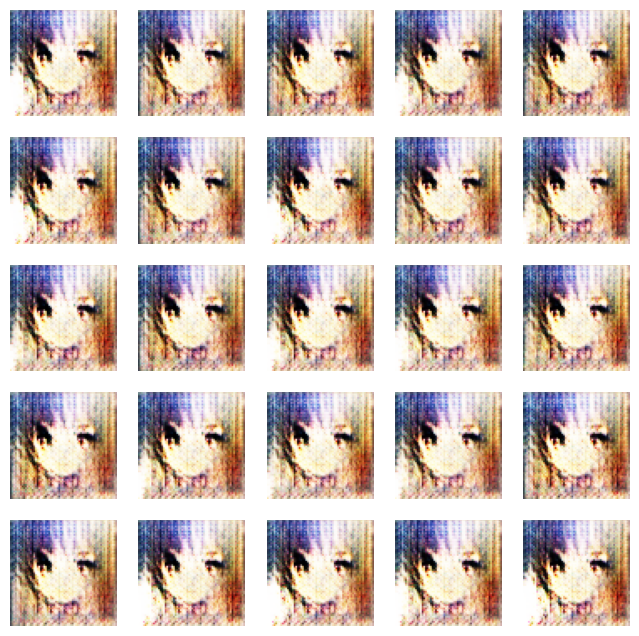

674/674 [==============================] - 55s 82ms/step - d_loss: 8.7411 - g_loss: 1.6945
Epoch 47/50
673/674 [============================>.] - ETA: 0s - d_loss: 8.4779 - g_loss: 1.7616

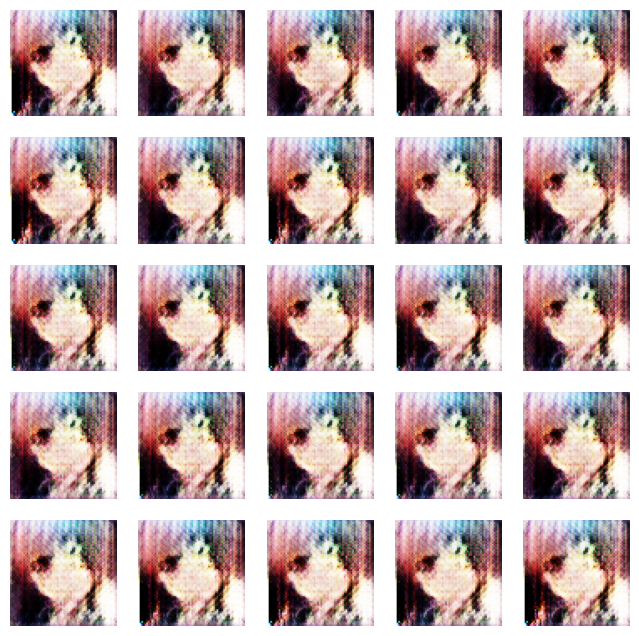

674/674 [==============================] - 55s 82ms/step - d_loss: 8.4790 - g_loss: 1.7610
Epoch 48/50
673/674 [============================>.] - ETA: 0s - d_loss: 7.7352 - g_loss: 1.9473

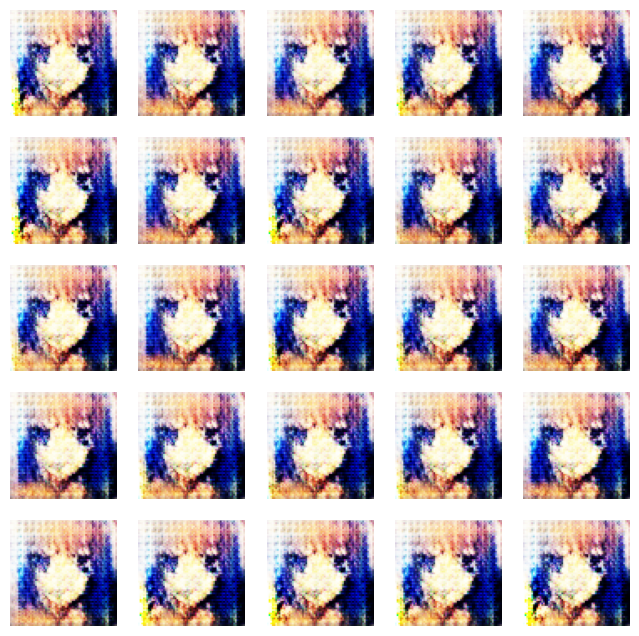

674/674 [==============================] - 56s 83ms/step - d_loss: 7.7281 - g_loss: 1.9502
Epoch 49/50
673/674 [============================>.] - ETA: 0s - d_loss: 7.0033 - g_loss: 1.7253

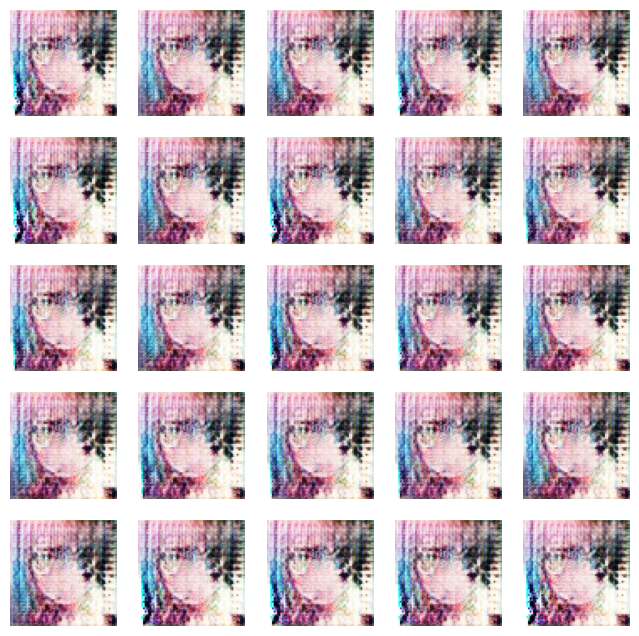

674/674 [==============================] - 55s 82ms/step - d_loss: 7.0076 - g_loss: 1.7246
Epoch 50/50
673/674 [============================>.] - ETA: 0s - d_loss: 8.1732 - g_loss: 1.9071

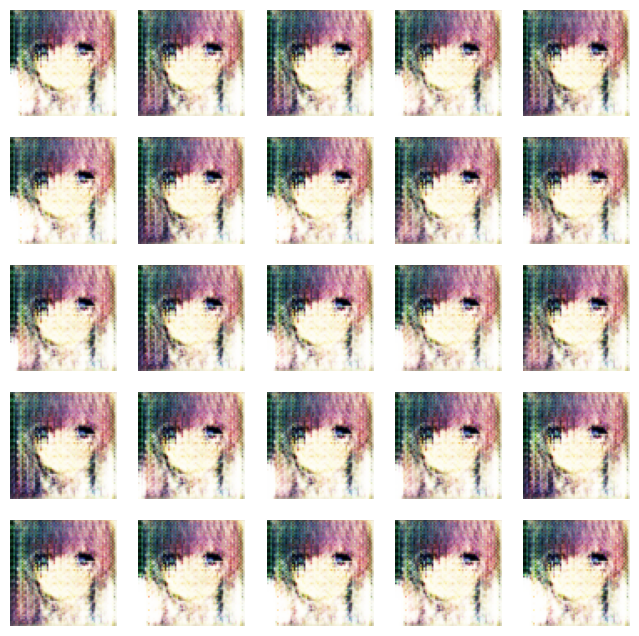

674/674 [==============================] - 56s 83ms/step - d_loss: 8.1708 - g_loss: 1.9045


In [ ]:
N_EPOCHS = 50
dcgan.fit(train_images, epochs = N_EPOCHS, callbacks = [DCGANMonitor()])

## Generate new Images from model

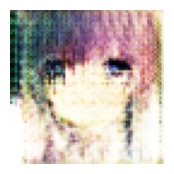

In [ ]:
noise = tf.random.normal([1,100])
fig = plt.figure(figsize = (2,2))
## generate image from noise
g_img = dcgan.generator(noise)
g_img = (g_img*127.5) +127.5 ##denormalization of image
g_img.numpy()
img = array_to_img(g_img[0])
plt.imshow(img)
plt.axis('off')
# plt.savefig('epoch_{:03d}.png'.format(epoch))
plt.show()

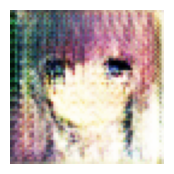

In [ ]:
noise = tf.random.normal([1,100])
fig = plt.figure(figsize = (2,2))
## generate image from noise
g_img = dcgan.generator(noise)
g_img = (g_img*127.5) +127.5 ##denormalization of image
g_img.numpy()
img = array_to_img(g_img[0])
plt.imshow(img)
plt.axis('off')
# plt.savefig('epoch_{:03d}.png'.format(epoch))
plt.show()

## Saving the model

In [ ]:
dcgan.generator.save('dcgan.h5')